In [1]:
# Import libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import model_selection
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neighbors import KNeighborsClassifier
from catboost import CatBoostClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier
from sklearn.metrics import classification_report
import shap
import optuna
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

## Preprocessing

In [2]:
# Import data
data = pd.read_csv("creditcard.csv")

In [3]:
# Examine the data
data.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [4]:
# Info about the dataset
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [5]:
# Check for missing values
data.isna().sum()

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

In [6]:
# Descriptive statistics
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Time,284807.0,9.481386e+04,47488.145955,0.000000,54201.500000,84692.000000,139320.500000,172792.000000
V1,284807.0,1.168375e-15,1.958696,-56.407510,-0.920373,0.018109,1.315642,2.454930
V2,284807.0,3.416908e-16,1.651309,-72.715728,-0.598550,0.065486,0.803724,22.057729
V3,284807.0,-1.379537e-15,1.516255,-48.325589,-0.890365,0.179846,1.027196,9.382558
V4,284807.0,2.074095e-15,1.415869,-5.683171,-0.848640,-0.019847,0.743341,16.875344
V5,284807.0,9.604066e-16,1.380247,-113.743307,-0.691597,-0.054336,0.611926,34.801666
V6,284807.0,1.487313e-15,1.332271,-26.160506,-0.768296,-0.274187,0.398565,73.301626
V7,284807.0,-5.556467e-16,1.237094,-43.557242,-0.554076,0.040103,0.570436,120.589494
V8,284807.0,1.213481e-16,1.194353,-73.216718,-0.208630,0.022358,0.327346,20.007208
V9,284807.0,-2.406331e-15,1.098632,-13.434066,-0.643098,-0.051429,0.597139,15.594995


In [7]:
# Set the maximum number of rows to display to None (to display all rows)
pd.set_option('display.max_rows', None)

# Grouped statistics by Class
data.groupby(['Class']).describe().T

Class                     0              1
Time   count  284315.000000     492.000000
       mean    94838.202258   80746.806911
       std     47484.015786   47835.365138
       min         0.000000     406.000000
       25%     54230.000000   41241.500000
       50%     84711.000000   75568.500000
       75%    139333.000000  128483.000000
       max    172792.000000  170348.000000
V1     count  284315.000000     492.000000
       mean        0.008258      -4.771948
       std         1.929814       6.783687
       min       -56.407510     -30.552380
       25%        -0.917544      -6.036063
       50%         0.020023      -2.342497
       75%         1.316218      -0.419200
       max         2.454930       2.132386
V2     count  284315.000000     492.000000
       mean       -0.006271       3.623778
       std         1.636146       4.291216
       min       -72.715728      -8.402154
       25%        -0.599473       1.188226
       50%         0.064070       2.717869
       75%         0.800446       4.971257
       max        18.902453      22.057729
V3     count  284315.000000     492.000000
       mean        0.012171      -7.033281
       std         1.459429       7.110937
       min       -48.325589     -31.103685
       25%        -0.884541      -8.643489
       50%         0.182158      -5.075257
       75%         1.028372      -2.276185
       max         9.382558       2.250210
V4     count  284315.000000     492.000000
       mean       -0.007860       4.542029
       std         1.399333       2.873318
       min        -5.683171      -1.313275
       25%        -0.850077       2.373050
       50%        -0.022405       4.177147
       75%         0.737624       6.348729
       max        16.875344      12.114672
V5     count  284315.000000     492.000000
       mean        0.005453      -3.151225
       std         1.356952       5.372468
       min      -113.743307     -22.105532
       25%        -0.689398      -4.792835
       50%        -0.053457      -1.522962
       75%         0.612181       0.214562
       max        34.801666      11.095089
V6     count  284315.000000     492.000000
       mean        0.002419      -1.397737
       std         1.329913       1.858124
       min       -26.160506      -6.406267
       25%        -0.766847      -2.501511
       50%        -0.273123      -1.424616
       75%         0.399619      -0.413216
       max        73.301626       6.474115
V7     count  284315.000000     492.000000
       mean        0.009637      -5.568731
       std         1.178812       7.206773
       min       -31.764946     -43.557242
       25%        -0.551442      -7.965295
       50%         0.041138      -3.034402
       75%         0.571019      -0.945954
       max       120.589494       5.802537
V8     count  284315.000000     492.000000
       mean       -0.000987       0.570636
       std         1.161283       6.797831
       min       -73.216718     -41.044261
       25%        -0.208633      -0.195336
       50%         0.022041       0.621508
       75%         0.326200       1.764879
       max        18.709255      20.007208
V9     count  284315.000000     492.000000
       mean        0.004467      -2.581123
       std         1.089372       2.500896
       min        -6.290730     -13.434066
       25%        -0.640412      -3.872383
       50%        -0.049964      -2.208768
       75%         0.598230      -0.787850
       max        15.594995       3.353525
V10    count  284315.000000     492.000000
       mean        0.009824      -5.676883
       std         1.044204       4.897341
       min       -14.741096     -24.588262
       25%        -0.532880      -7.756698
       50%        -0.091872      -4.578825
       75%         0.455135      -2.614184
       max        23.745136       4.031435
V11    count  284315.000000     492.000000
       mean       -0.006576       3.800173
       std         1.003112       2.678605
       min        -4.797473      -1.702228
 

## Explororatory data analysis (EDA)

In [8]:
# Set the Seaborn theme to a whitegrid style
sns.set_theme(style="whitegrid")

Time
Skew : -0.04


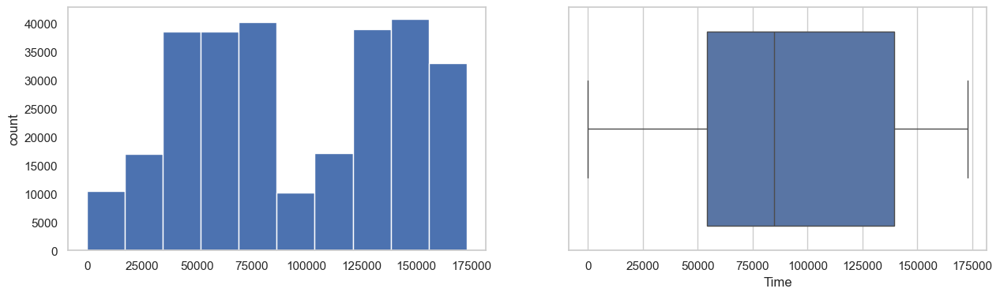

V1
Skew : -3.28


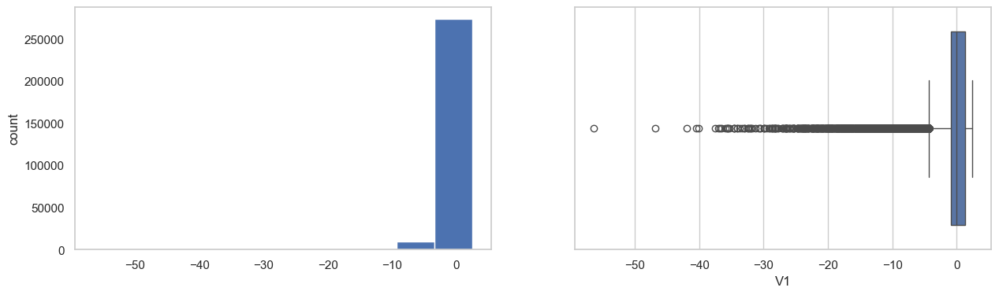

V2
Skew : -4.62


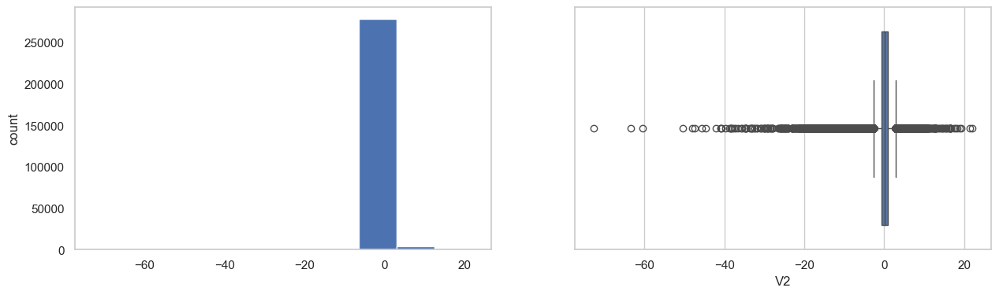

V3
Skew : -2.24


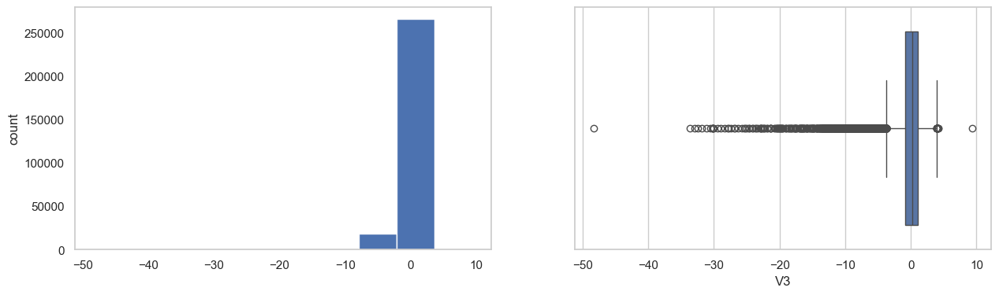

V4
Skew : 0.68


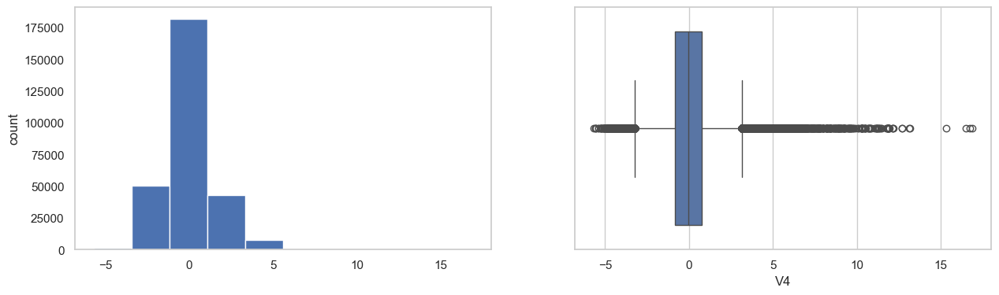

V5
Skew : -2.43


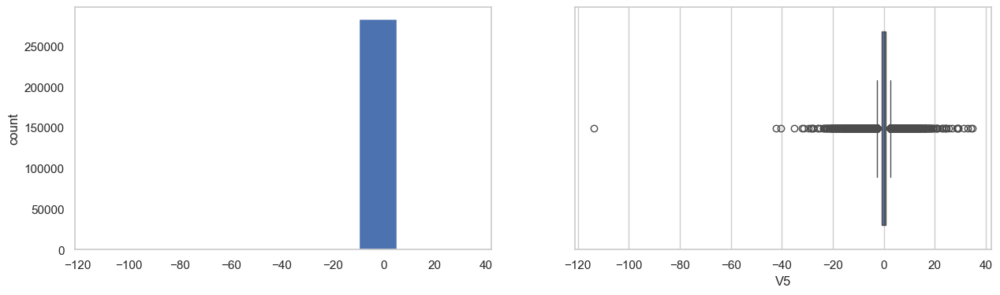

V6
Skew : 1.83


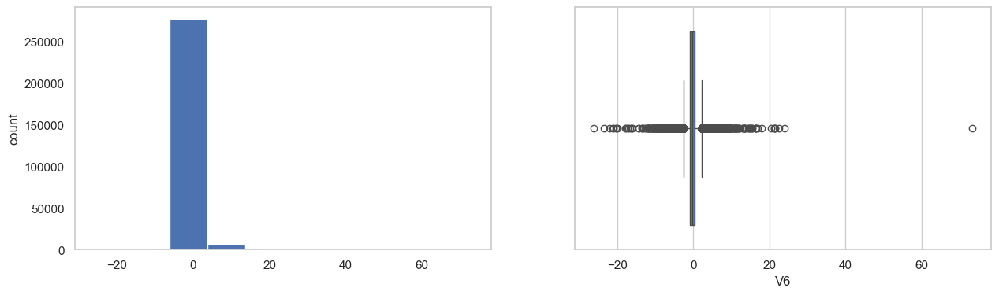

V7
Skew : 2.55


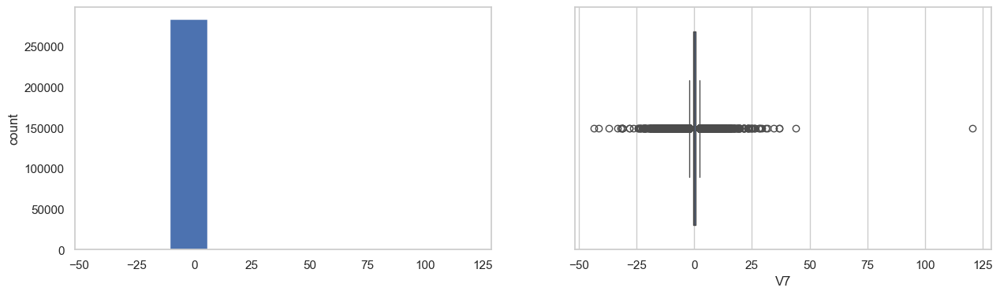

V8
Skew : -8.52


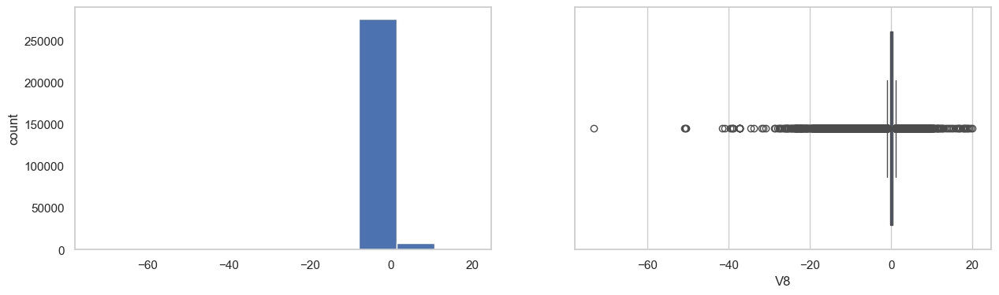

V9
Skew : 0.55


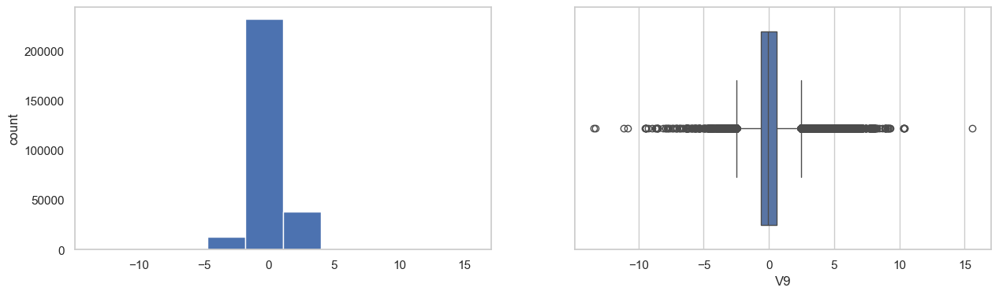

V10
Skew : 1.19


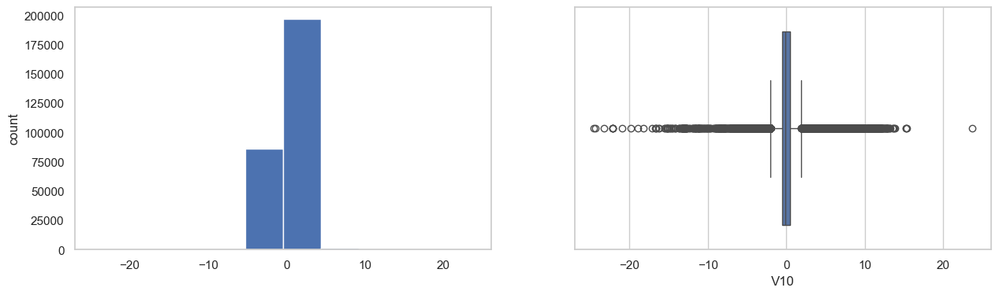

V11
Skew : 0.36


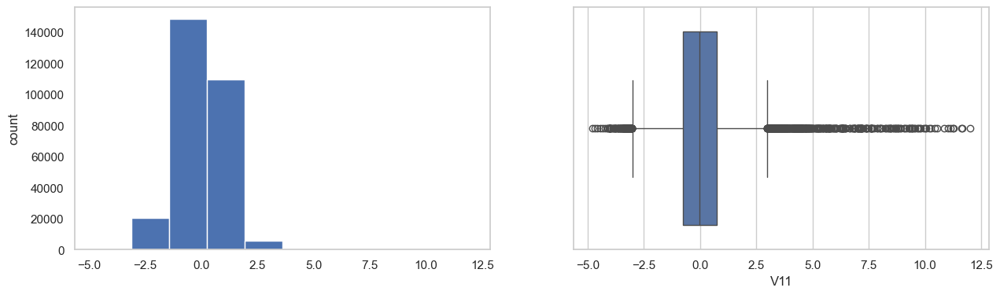

V12
Skew : -2.28


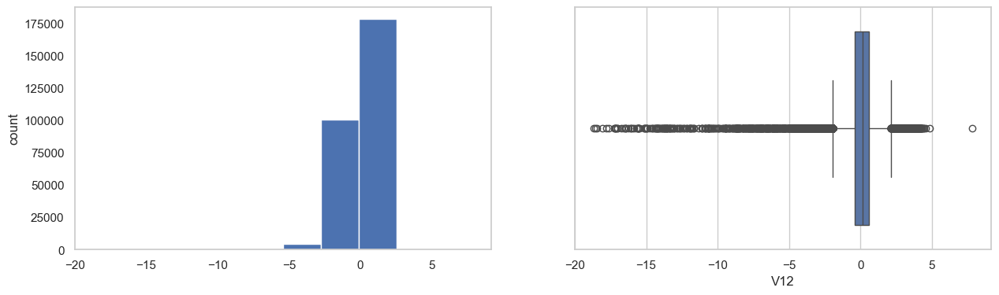

V13
Skew : 0.07


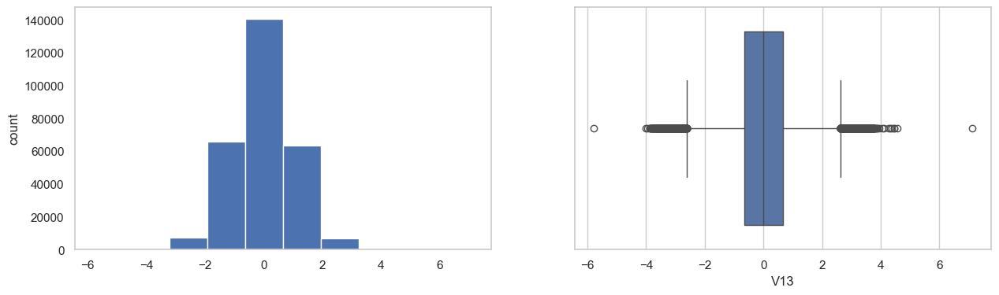

V14
Skew : -2.0


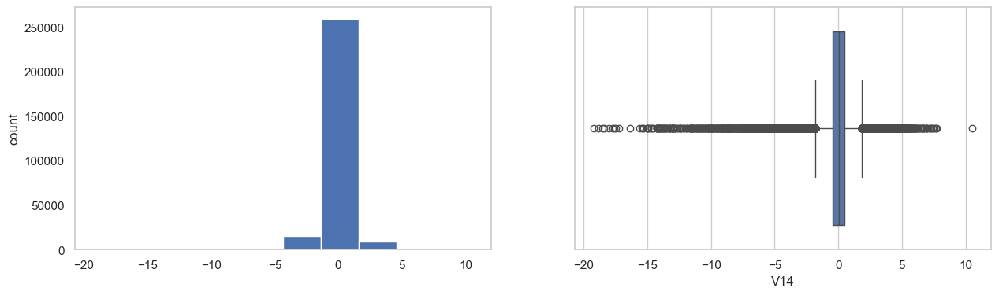

V15
Skew : -0.31


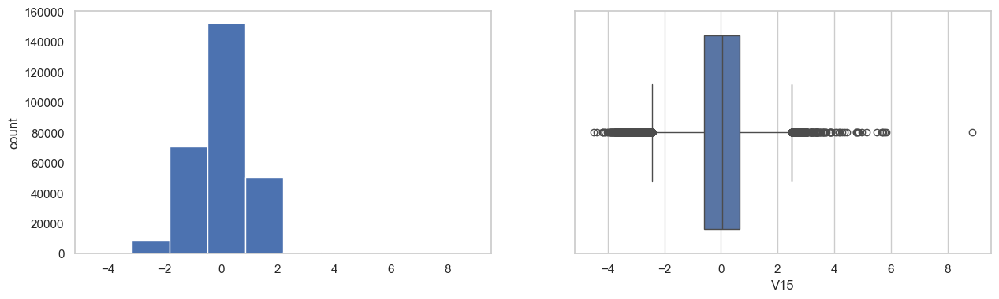

V16
Skew : -1.1


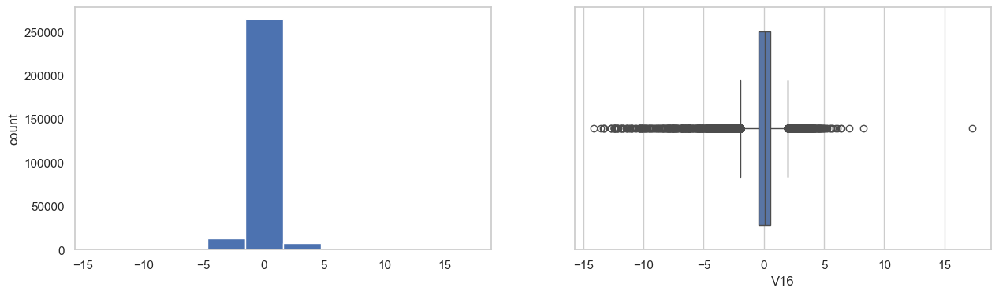

V17
Skew : -3.84


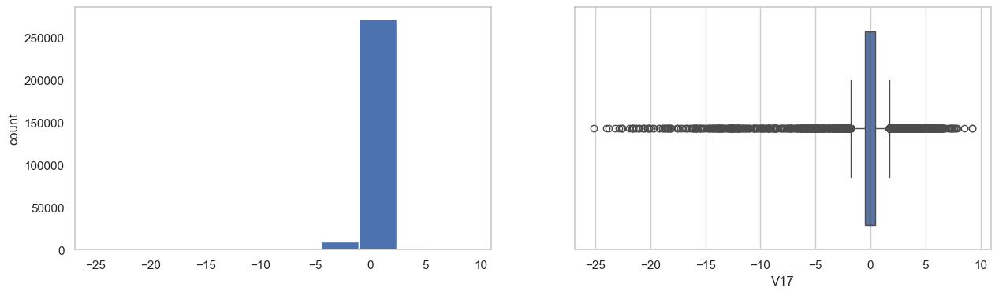

V18
Skew : -0.26


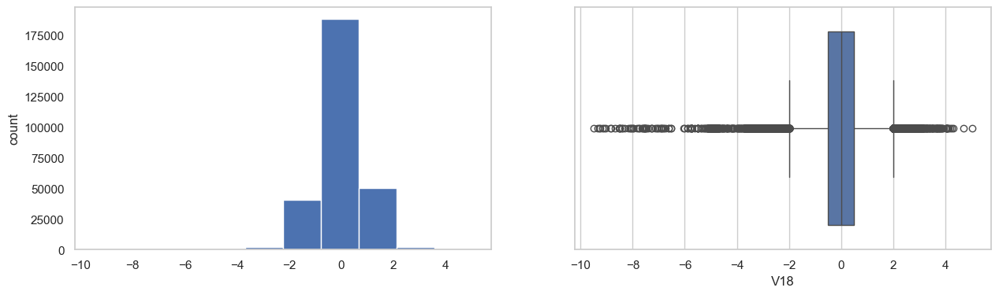

V19
Skew : 0.11


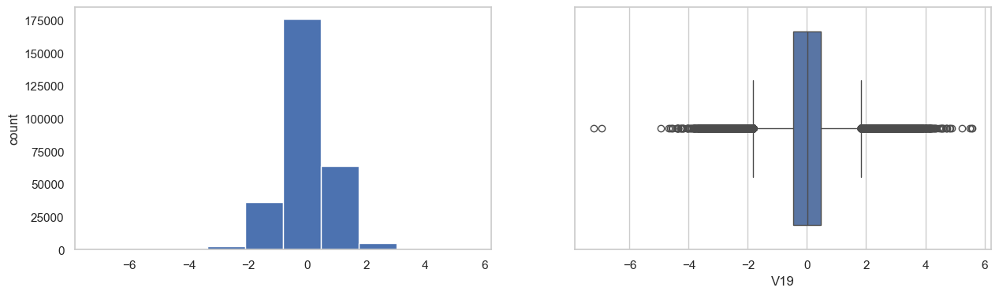

V20
Skew : -2.04


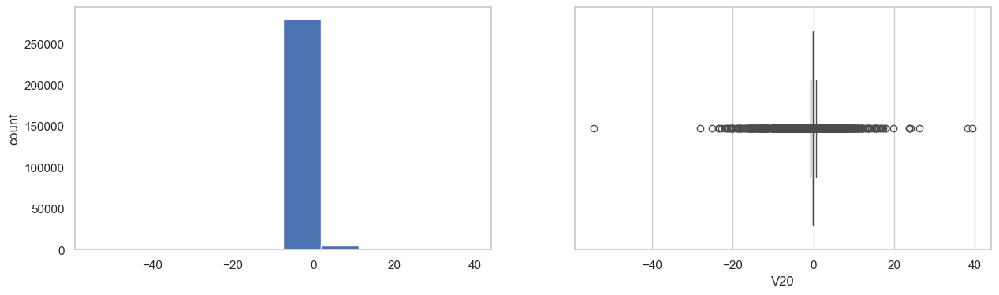

V21
Skew : 3.59


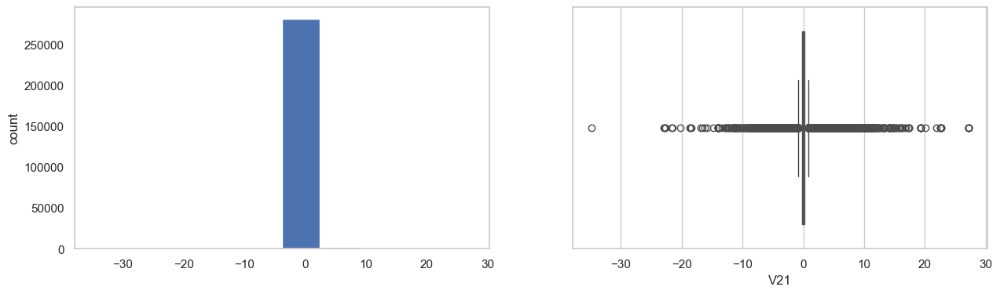

V22
Skew : -0.21


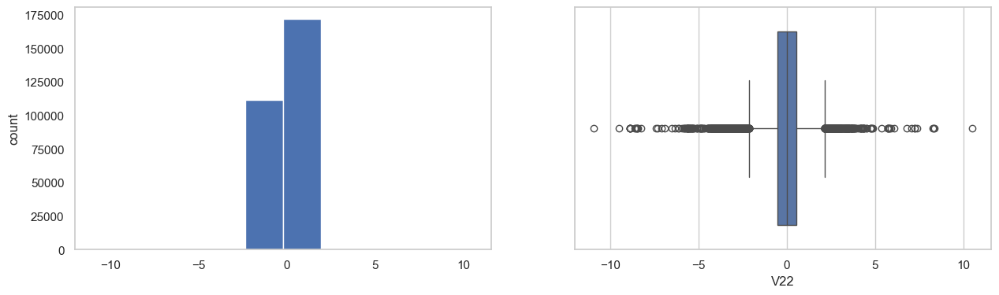

V23
Skew : -5.88


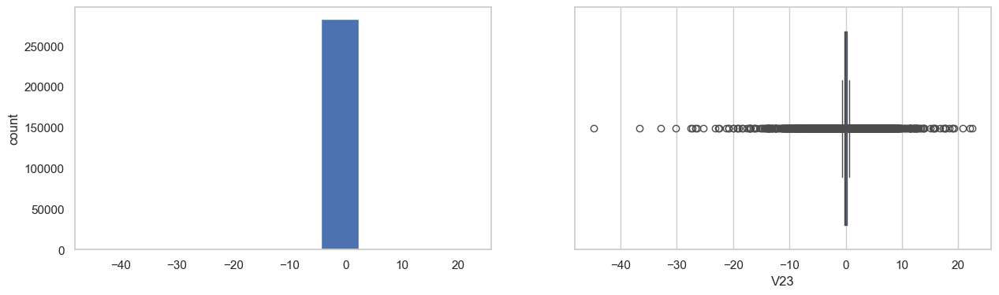

V24
Skew : -0.55


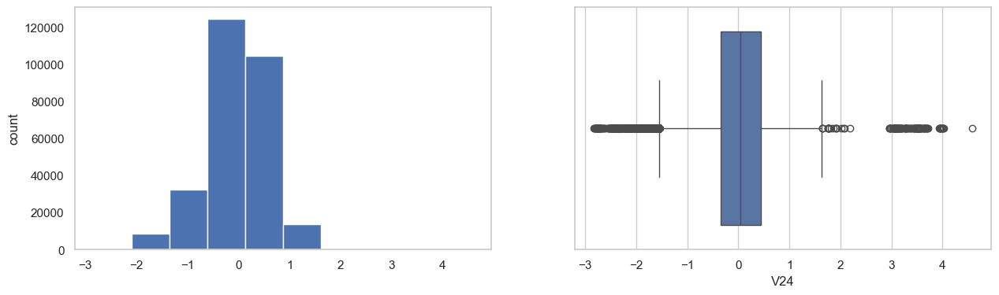

V25
Skew : -0.42


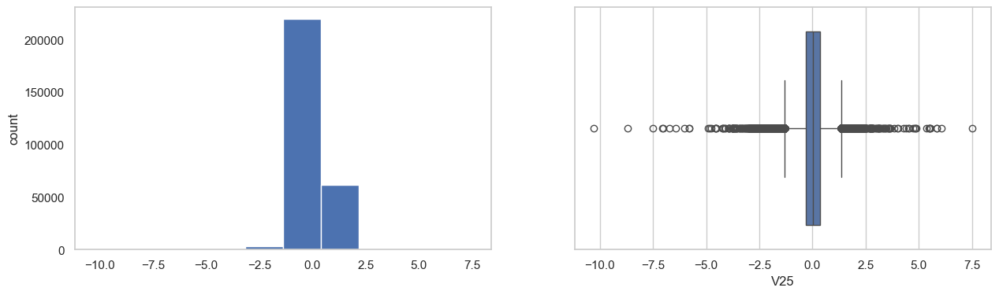

V26
Skew : 0.58


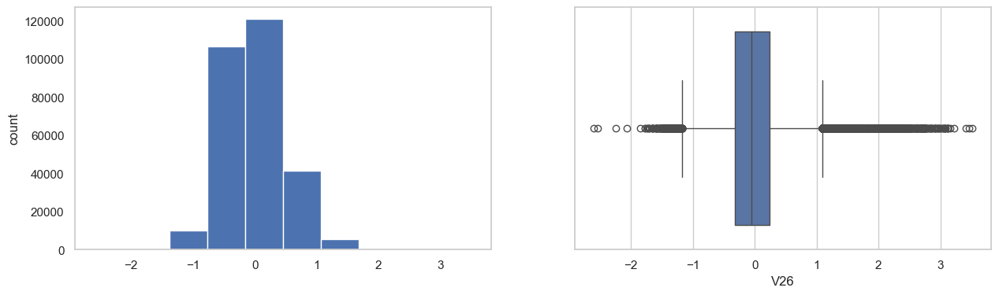

V27
Skew : -1.17


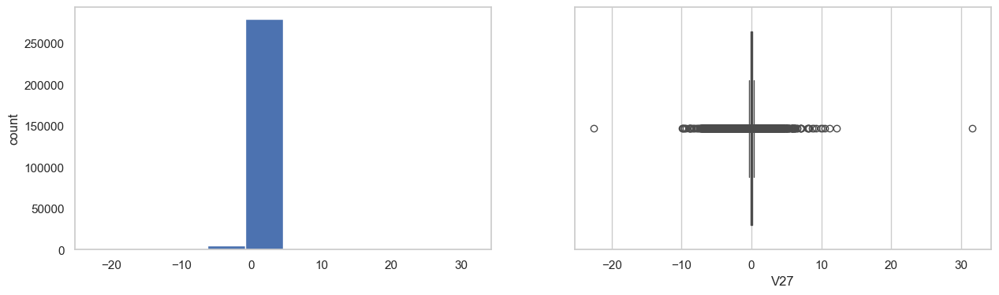

V28
Skew : 11.19


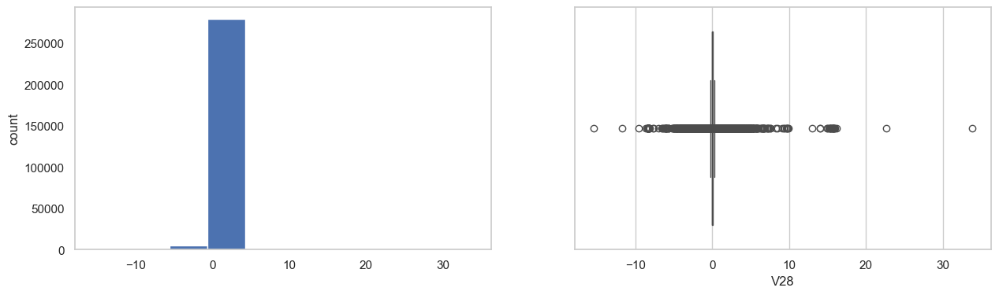

Amount
Skew : 16.98


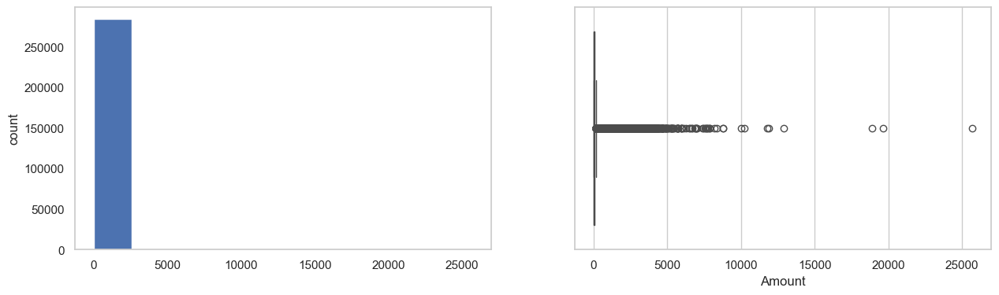

Class
Skew : 24.0


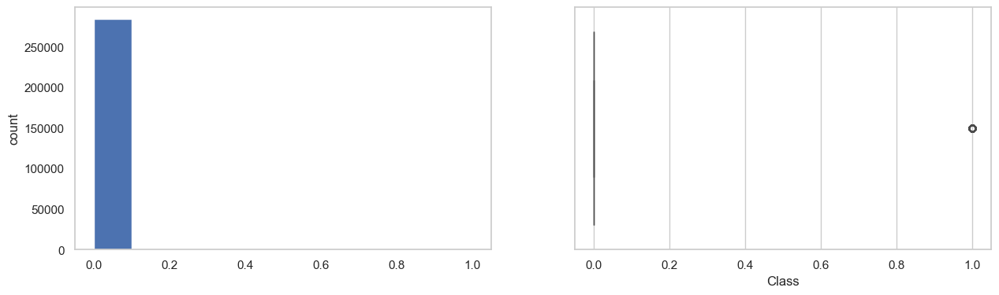

In [9]:
# Histograms and boxplots for features
for col in data.columns:
    print(col)
    print('Skew :', round(data[col].skew(), 2))
    plt.figure(figsize = (15, 4))
    plt.subplot(1, 2, 1)
    data[col].hist(grid=False)
    plt.ylabel('count')
    plt.subplot(1, 2, 2)
    sns.boxplot(x=data[col])
    plt.show()

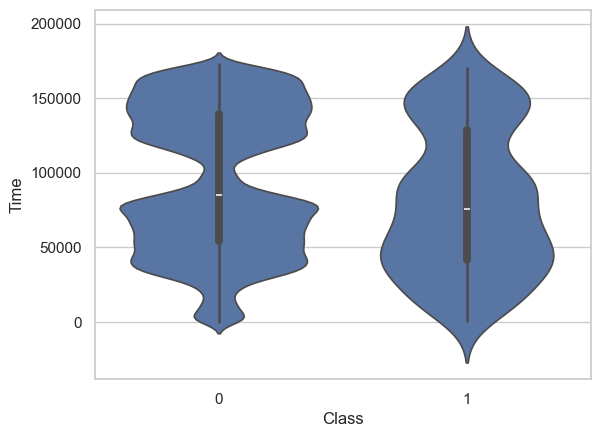

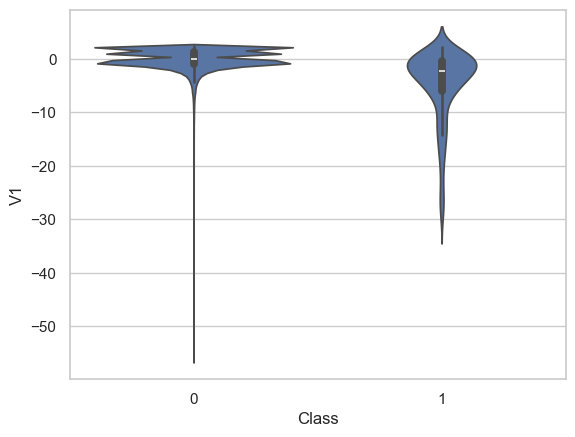

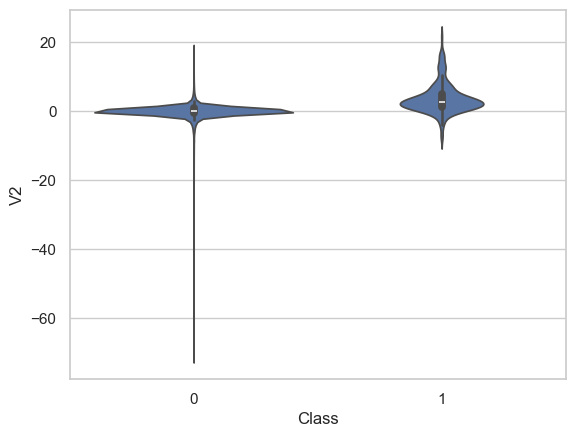

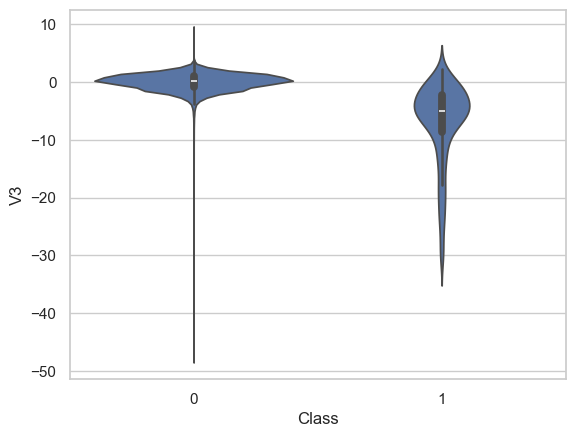

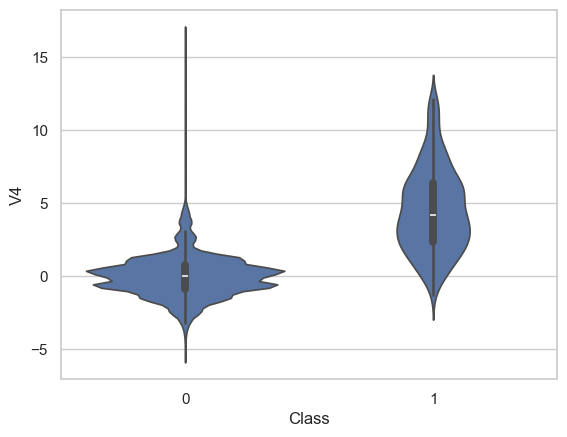

...

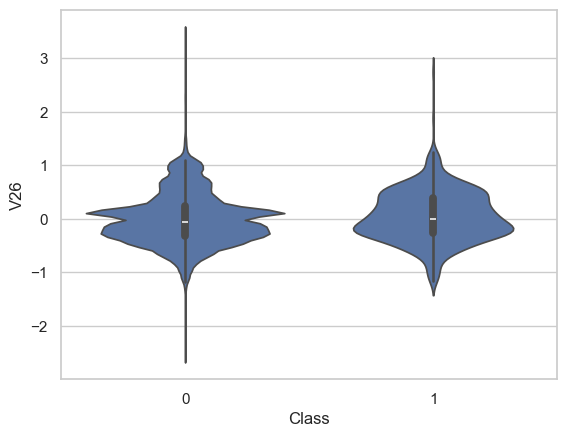

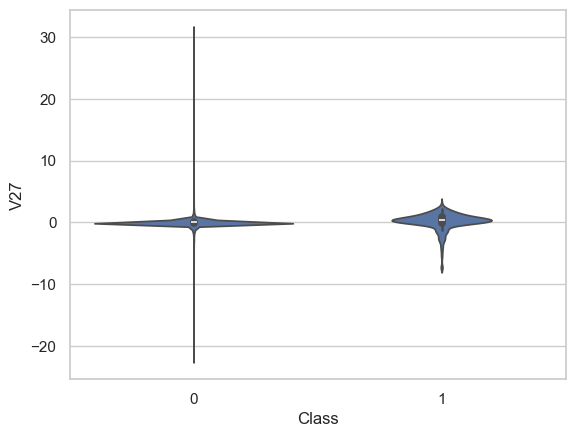

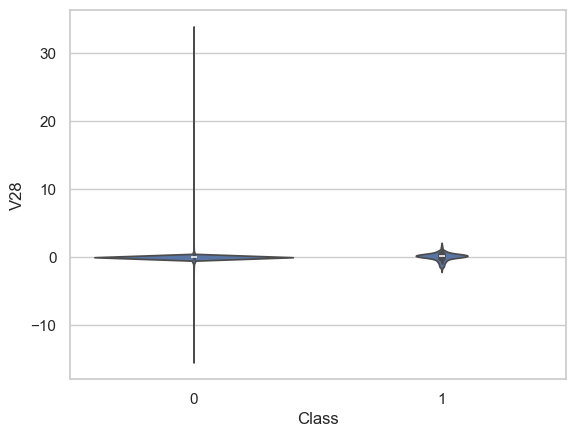

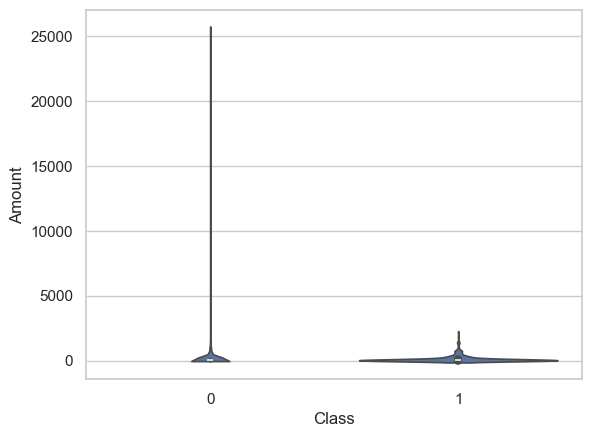

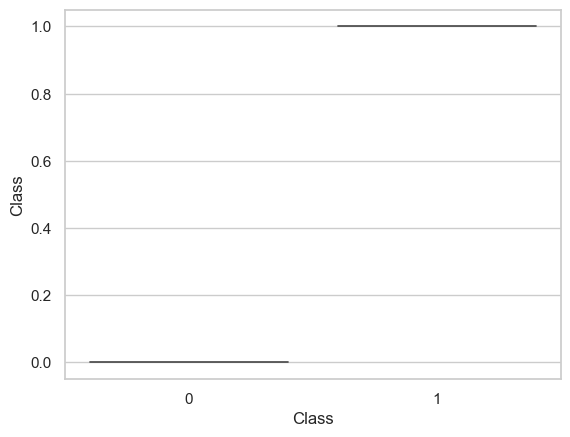

In [10]:
# Distribution of Class
for col in data.columns:
    ax = sns.violinplot(x='Class', y=col, data=data)
    plt.show()

In [11]:
# Undersampling for visualisations
fraud_df = data.loc[data['Class'] == 1]
non_fraud_df = data.loc[data['Class'] == 0].sample(492)

data_vis = pd.concat([fraud_df, non_fraud_df])

In [12]:
# Plot pairplot between numeric columns
sns.set_theme(style="whitegrid")
sns.pairplot(data_vis, height=3, hue="Class", palette='bright')
sns.set(font_scale=0.8) 

<Axes: >

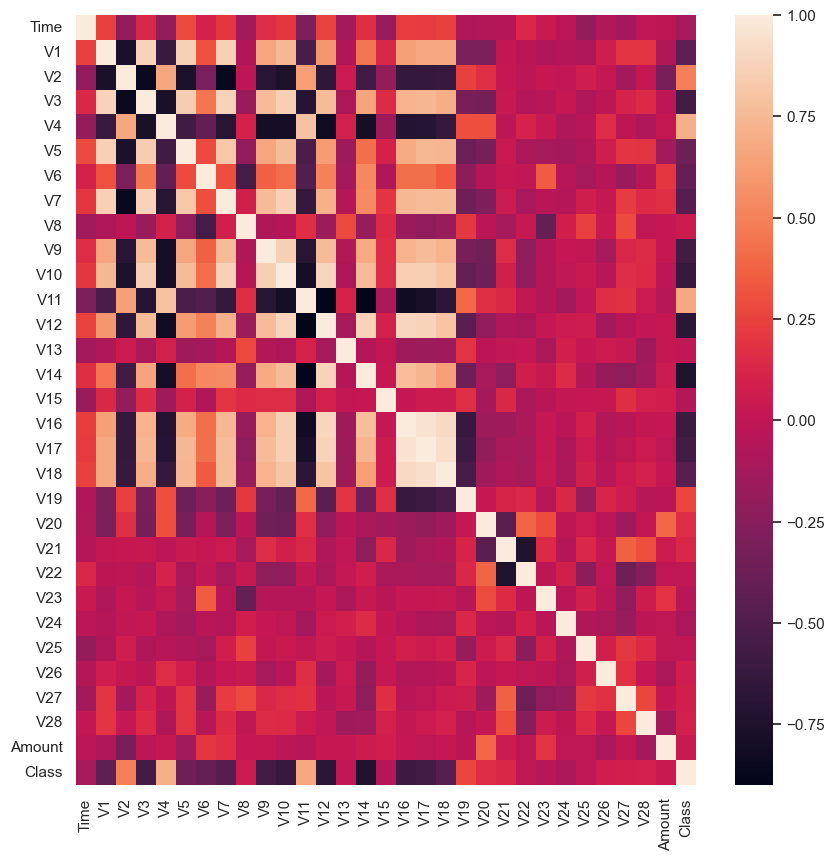

In [13]:
# Plot correlations
sns.set_theme(style="whitegrid")
corr = data_vis.corr(numeric_only=True)
plt.figure(figsize=(10,10))
sns.heatmap(corr)

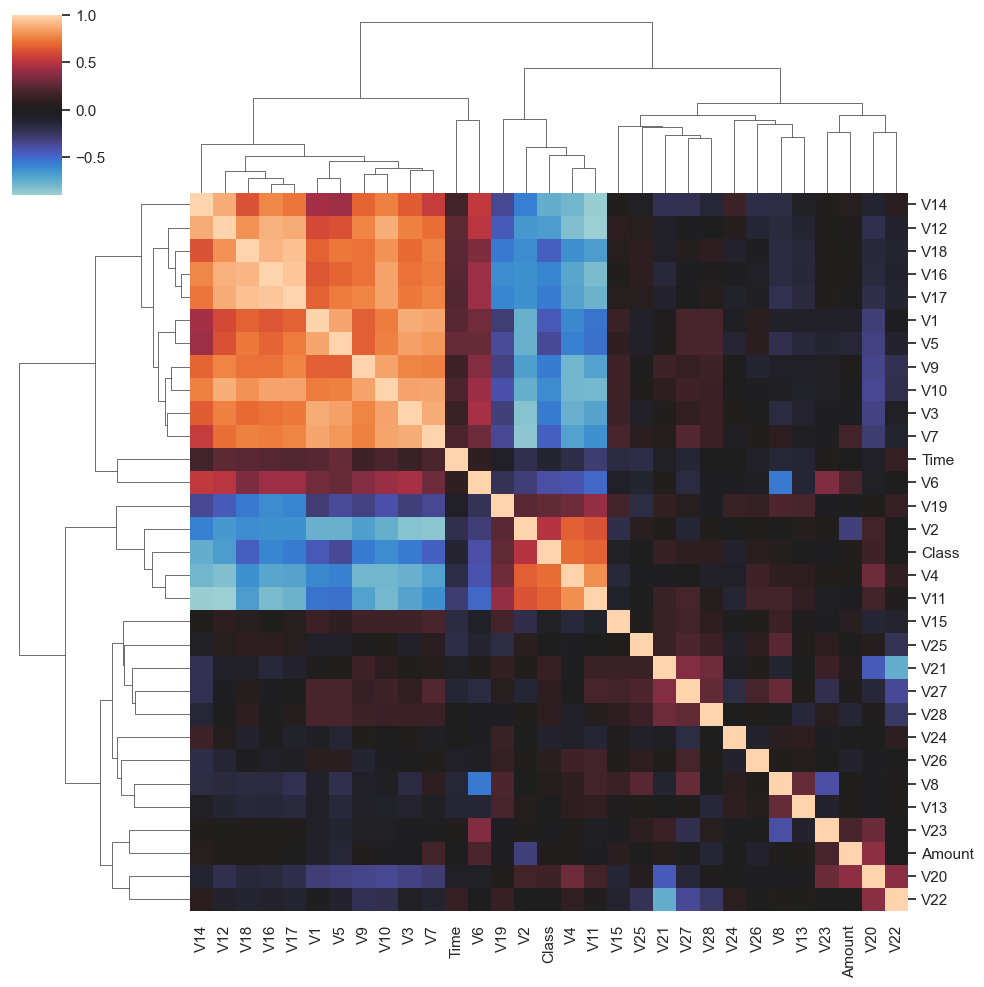

In [14]:
# Plot feature clustering
sns.clustermap(data_vis.corr(numeric_only=True), center=0)

In [15]:
# Undersampling
fraud_df = data.loc[data['Class'] == 1]
non_fraud_df = data.loc[data['Class'] == 0].sample(20000)

data = pd.concat([fraud_df, non_fraud_df])

## Modelling

In [16]:
# Split data between dependent and independent variables
X = data.drop('Class', axis=1)
y = data['Class']
X_train, _, y_train, _ = train_test_split(X, y, test_size=0.25, random_state=0)

In [17]:
# For testing get full dataset not just subsample
data = pd.read_csv("creditcard.csv")
X_full = data.drop('Class', axis=1)
y_full = data['Class']
_, X_test, _, y_test = train_test_split(X_full, y_full, test_size=0.25, random_state=0)

In [18]:
# Run different models to compare
def run_exps(X_train, y_train, X_test, y_test):
    dfs = []
    results = []
    names = []
    # Define which models to test
    models = [
          ('Logistic Regression', LogisticRegression()),
          ('Random Forest', RandomForestClassifier()),
          ('KNN', KNeighborsClassifier()),
          ('CatBoost', CatBoostClassifier(verbose=False)),
          ('Bagging', BaggingClassifier()),
          ('LDA', LinearDiscriminantAnalysis()),
          ('XGB', XGBClassifier())
        ]

    # Specify scoring metrics and labels
    scoring = ['accuracy', 'precision', 'recall', 'f1', 'roc_auc']
    target_names = ['not-fraud', 'fraud']

    # Iterate through all models
    for name, model in models:
        # Do 3 fold cross validation
        kfold = model_selection.KFold(n_splits=3, shuffle=True, random_state=0)
        cv_results = model_selection.cross_validate(model, X_test, y_test, cv=kfold, scoring=scoring)
        # Fit the model
        clf = model.fit(X_train, y_train)
        # Make predictions
        y_pred = clf.predict(X_test)
        print(name)
        # Print classification repot
        print(classification_report(y_test, y_pred, target_names=target_names))
        # Append to the results
        results.append(cv_results)
        names.append(name)
        this_df = pd.DataFrame(cv_results)
        this_df['model'] = name
        dfs.append(this_df)
        
    final = pd.concat(dfs, ignore_index=True)
    return final
    
final = run_exps(X_train, y_train, X_test, y_test)

Logistic Regression
              precision    recall  f1-score   support

   not-fraud       1.00      1.00      1.00     71082
       fraud       0.34      0.84      0.48       120

    accuracy                           1.00     71202
   macro avg       0.67      0.92      0.74     71202
weighted avg       1.00      1.00      1.00     71202

Random Forest
              precision    recall  f1-score   support

   not-fraud       1.00      1.00      1.00     71082
       fraud       0.79      0.97      0.87       120

    accuracy                           1.00     71202
   macro avg       0.90      0.99      0.94     71202
weighted avg       1.00      1.00      1.00     71202

KNN
              precision    recall  f1-score   support

   not-fraud       1.00      1.00      1.00     71082
       fraud       0.16      0.12      0.14       120

    accuracy                           1.00     71202
   macro avg       0.58      0.56      0.57     71202
weighted avg       1.00      1.00   

Text(0.5, 1.0, 'Comparison of Model by Classification Metric')

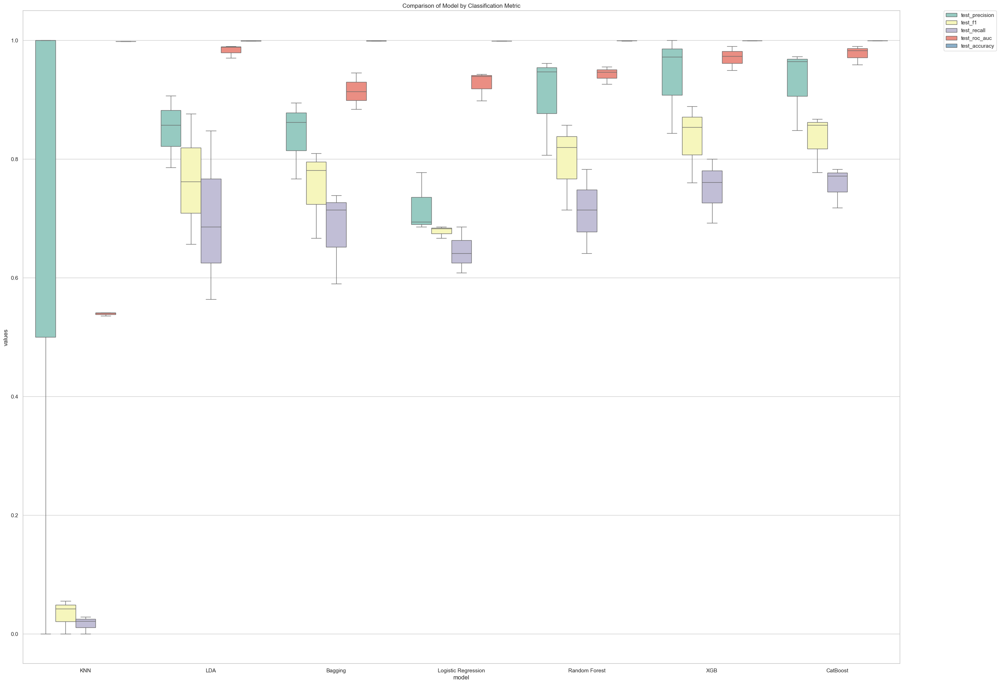

In [19]:
# Pivot the table
results_long = pd.melt(final, id_vars=['model'], var_name='metrics', value_name='values')

# Fit time metrics
time_metrics = ['fit_time', 'score_time'] 

# Get data without fit
results_long_nofit = results_long.loc[~results_long['metrics'].isin(time_metrics)] 
results_long_nofit = results_long_nofit.sort_values(by='values')

# Plot metrics for different models
plt.figure(figsize=(32, 24))
g = sns.boxplot(x="model", y="values", hue="metrics", data=results_long_nofit, palette="Set3")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('Comparison of Model by Classification Metric')

In [20]:
# Save metric comparison for tableau visualisation
results_long.to_csv("metric_comparison.csv", index=False)

In [21]:
def objective(trial):
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)
    
    # Suggest hyperparameters
    param = {
        "iterations": trial.suggest_int("iterations", 100, 1000),
        "learning_rate": trial.suggest_float("learning_rate", 1e-3, 0.3, log=True),
        "depth": trial.suggest_int("depth", 4, 10),
        "l2_leaf_reg": trial.suggest_float("l2_leaf_reg", 1e-3, 10, log=True),
        "border_count": trial.suggest_int("border_count", 32, 255),
        "loss_function": "Logloss",
        "eval_metric": "AUC",
        "random_seed": 42,
        "verbose": False,
    }

    # Create the classifier model with the suggested hyperparameters
    model = CatBoostClassifier(**param)
    
    # Train the model
    model.fit(X_train, y_train, 
          eval_set=[(X_test, y_test)],
          verbose=False)
    
    # Make predictions
    preds = model.predict(X_test)
    
    # Calculate accuracy
    accuracy = accuracy_score(y_test, preds)
    
    return accuracy

# Create a study object and specify that we want to maximize accuracy
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=20)

# Output the best parameters and the best score
print("Best trial:")
print(study.best_trial.params)

best_params = study.best_trial.params

[I 2025-03-04 19:35:54,704] A new study created in memory with name: no-name-fe208227-ccde-48bb-97a2-6c1bbf5f4b4f
[I 2025-03-04 19:36:01,462] Trial 0 finished with value: 0.995608685045133 and parameters: {'iterations': 885, 'learning_rate': 0.11151189837398591, 'depth': 4, 'l2_leaf_reg': 1.033226659999579, 'border_count': 110}. Best is trial 0 with value: 0.995608685045133.
[I 2025-03-04 19:36:10,576] Trial 1 finished with value: 0.99585264698707 and parameters: {'iterations': 522, 'learning_rate': 0.059267481563127826, 'depth': 8, 'l2_leaf_reg': 0.061449528975144656, 'border_count': 253}. Best is trial 1 with value: 0.99585264698707.
[I 2025-03-04 19:36:19,173] Trial 2 finished with value: 0.9960966089290071 and parameters: {'iterations': 384, 'learning_rate': 0.027880864504313468, 'depth': 9, 'l2_leaf_reg': 0.0065429338048244015, 'border_count': 144}. Best is trial 2 with value: 0.9960966089290071.
[I 2025-03-04 19:36:25,226] Trial 3 finished with value: 0.9939009514515735 and param

Best trial:
{'iterations': 111, 'learning_rate': 0.029888067447727866, 'depth': 6, 'l2_leaf_reg': 0.21185146525013773, 'border_count': 205}


In [22]:
# Run CatBoostClassifier
model = CatBoostClassifier(**best_params)
model.fit(X_train, y_train, verbose=0)
model_features = X_train.columns

# Expected columns
for column in model_features:
    if column not in X_train.columns:
        X_test[column] = 0

# Rearange columns
X_test = X_test[model_features]

# Predictions
y_pred = model.predict(X_test)
print(classification_report(y_test, y_pred, target_names=['not-fraud', 'fraud']))

              precision    recall  f1-score   support

   not-fraud       1.00      1.00      1.00     71082
       fraud       0.85      0.87      0.86       120

    accuracy                           1.00     71202
   macro avg       0.92      0.93      0.93     71202
weighted avg       1.00      1.00      1.00     71202



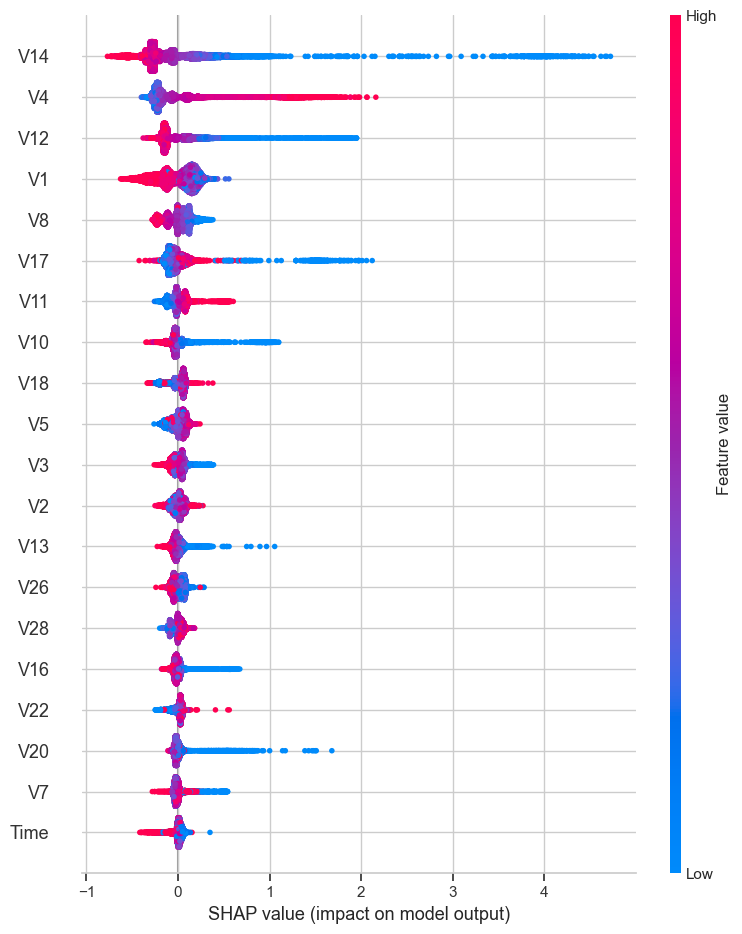

In [23]:
# Create a CatBoostClassifier model
model = CatBoostClassifier(**best_params)
model.fit(X_train, y_train, verbose=0)
y_pred = model.predict(X_test)

# Plot feature importance
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_train)

# Plot summary
shap.summary_plot(shap_values, X_train)